# Imports/Setup

In [1]:
%%capture
!pip install drain3

In [2]:
import tensorflow as tf
import pandas as pd
import sklearn
import re
import numpy as np
from copy import deepcopy
from tqdm.notebook import tqdm
import joblib
import plotly.express as px
from drain3 import TemplateMiner
import logging
import os
import datetime
from datetime import timedelta
import sys
from collections import defaultdict
import plotly.graph_objects as go

2021-10-28 19:03:33.768768: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0


In [5]:
logging.basicConfig(
    format='%(asctime)s %(levelname)s | %(message)s',
    level=logging.INFO,
    stream=sys.stdout
)

logger = logging.getLogger('notebook_logger')

## Find and Prepare Data

In [6]:
def get_data(path: str) -> pd.DataFrame():
    ret_data = dict()
    logger.info('Building data dictionary ...')
    _, dirs, _ = next(os.walk(path))
    for directory in dirs:
        logging.info(f'directory found: {directory}')
        _, _, files = next(os.walk(f'{path}/{directory}'))
        for file in files:
            accpt_params = ['.csv', 'base', 'Logs']
            unaccpt_params = ['.~lock', 'OLD']
            if (all(p in file for p in accpt_params) and
                all(p not in file for p in unaccpt_params)):
                logging.info(f'file found: {file}')
                data = pd.read_csv(f'{path}/{directory}/{file}')
                #data = clean_logs('log', data)                           # clean logs by removing internal timestamps
                data['timestamp'] = pd.to_numeric(data['timestamp'])
                data['timestamp'] = pd.to_datetime(data['timestamp'], unit='s')  # replace time since unix time with actual datetime obj
                data.set_index('timestamp', inplace=True)   # set index to be the timestamp
                data.sort_index(inplace=True)
                ret_data[directory] = data
    logger.info('...complete!')
    return ret_data

In [9]:
data = get_data('../../data')

2021-10-28 19:05:22,650 INFO | Building data dictionary ...
2021-10-28 19:05:22,651 INFO | directory found: 2021-10-11_1633944527
2021-10-28 19:05:22,652 INFO | file found: SoaesbLogsPipeline_base.csv
2021-10-28 19:05:23,016 INFO | directory found: 2021-10-10_1633858095
2021-10-28 19:05:23,017 INFO | file found: SoaesbLogsPipeline_base.csv
2021-10-28 19:05:23,338 INFO | directory found: 2021-10-12_1634030876
2021-10-28 19:05:23,339 INFO | file found: SoaesbLogsPipeline_base.csv
2021-10-28 19:05:23,654 INFO | directory found: 2021-10-12_1634026757
2021-10-28 19:05:23,656 INFO | file found: SoaesbLogsPipeline_base.csv
2021-10-28 19:05:23,731 INFO | directory found: 2021-10-12_1634053503
2021-10-28 19:05:23,731 INFO | file found: SoaesbLogsPipeline_base.csv
2021-10-28 19:05:24,682 INFO | directory found: 2021-10-09_1633771683
2021-10-28 19:05:24,683 INFO | file found: SoaesbLogsPipeline_base.csv
2021-10-28 19:05:24,981 INFO | directory found: 2021-10-12_1634016461
2021-10-28 19:05:24,982 

In [10]:
tempdf = data[list(data.keys())[0]].copy()
tempdf.head()

,container_name,log,label
timestamp,,,
2021-10-11 03:00:07.880999936,healthcheck,2021-10-11 03:00:02 INFO HealthCheckService:1...,healthy
2021-10-11 03:00:07.880999936,healthcheck,2021-10-11 03:00:02 INFO HealthCheckService:1...,healthy
2021-10-11 03:00:07.880999936,healthcheck,2021-10-11 03:00:02 INFO HealthCheckService:1...,healthy
2021-10-11 03:00:07.880999936,healthcheck,2021-10-11 03:00:02 INFO HealthCheckService:1...,healthy
2021-10-11 03:00:08.161999872,3.master.broker.soaesb,"2021-10-11 03:00:08,043 ERROR [org.apache.acti...",healthy


In [11]:
llll = ['filebeat', '1.master.broker.soaesb']
for x in llll:
    mask_this = tempdf[tempdf['container_name'].str.contains(x)]
    tempdf.drop(mask_this.index, inplace=True)

In [12]:
tempdf[tempdf['container_name'] == '1.master.broker.soaesb']

,container_name,log,label
timestamp,,,


# Mr. Clean 

In [21]:
def clean_logs(logs: pd.DataFrame, column_name: str) -> pd.DataFrame:
    logger.info('Applying log cleaner:')
    
    logs_copy = deepcopy(logs)
    
    logger.info('Cleaning timestamps ...')
    regex_dict = {'timestamps': re.compile(
                    r"""
                    (?:               # Match all enclosed
                    \d{4}-\d{2}-\d{2} # YYYY-MM-DD
                    [\sT]             # Accept either a space or T
                    \d{2}:\d{2}:\d{2} # HH:MM:SS
                    ([.,]\d{3}|\s)    # Accept either a space or milliseconds
                    )                 # End timestamp match
                    | (?:\s{2,})      # Remove double spaces
                    """, re.X),       
                 'unwanted symbols:': re.compile(r'[^./:$a-zA-Z\d\s]', re.X),
                 'unwanted spaces': re.compile(r'\s+', re.X),
                 'isolated symbols': re.compile(
                    r"""
                    ((?<=\s)|(?<=\A)) # Look behind for whitespace (\s) or start of string (\A)
                    [a-zA-Z]{1}       # Match single alphabet chracter both upper and lowercase
                    ((?=\s)|(?=\Z))   # Look ahead for whitespace or end of string (\Z)
                    """, re.X),
                 'unwanted solr o.a.s...': re.compile(r'(o.a.s.(.\.)+)', re.X)}
    
    for key in tqdm(regex_dict.keys(), leave=False):
        logger.info(f'Cleaning {key} ...')
        logs_copy.loc[:, column_name].replace(
            to_replace=regex_dict[key],
            value=' ',
            regex=True,
            inplace=True)
    

    logger.info(f'... Finished cleaning logs, {len(logs_copy.index)} logs processed.')
    return logs_copy

In [22]:
def data_preprocessing_pipeline(data: dict) -> pd.DataFrame:
    logger.info('Starting preprocessing pipeline ...')
    
    ret_dict = dict()
    
    drop_keys = ['filebeat']
    
    for key in tqdm(data.keys(), desc='Walking through database...'):
        logs = data[key]
        out_logs = clean_logs(logs, 'log')
        mask = out_logs[out_logs['container_name'].isin(drop_keys)]
        out_logs.drop(mask.index, inplace=True)
        ret_dict[key] = out_logs
    
    logger.info('... Finished log preprocessing pipeline.')
    return ret_dict

In [23]:
cleaned_logs_dict = data_preprocessing_pipeline(data)

2021-10-28 20:06:28,964 INFO | Starting preprocessing pipeline ...


Walking through database...:   0%|          | 0/7 [00:00<?, ?it/s]

2021-10-28 20:06:28,994 INFO | Applying log cleaner:
2021-10-28 20:06:29,002 INFO | Cleaning timestamps ...


  0%|          | 0/5 [00:00<?, ?it/s]

2021-10-28 20:06:29,032 INFO | Cleaning timestamps ...
2021-10-28 20:06:30,331 INFO | Cleaning unwanted symbols: ...
2021-10-28 20:06:30,904 INFO | Cleaning unwanted spaces ...
2021-10-28 20:06:31,795 INFO | Cleaning isolated symbols ...
2021-10-28 20:06:33,210 INFO | Cleaning unwanted solr o.a.s... ...
2021-10-28 20:06:33,486 INFO | ... Finished cleaning logs, 278182 logs processed.
2021-10-28 20:06:33,545 INFO | Applying log cleaner:
2021-10-28 20:06:33,549 INFO | Cleaning timestamps ...


  0%|          | 0/5 [00:00<?, ?it/s]

2021-10-28 20:06:33,564 INFO | Cleaning timestamps ...
2021-10-28 20:06:34,889 INFO | Cleaning unwanted symbols: ...
2021-10-28 20:06:35,460 INFO | Cleaning unwanted spaces ...
2021-10-28 20:06:36,369 INFO | Cleaning isolated symbols ...
2021-10-28 20:06:37,712 INFO | Cleaning unwanted solr o.a.s... ...
2021-10-28 20:06:37,972 INFO | ... Finished cleaning logs, 286136 logs processed.
2021-10-28 20:06:38,032 INFO | Applying log cleaner:
2021-10-28 20:06:38,036 INFO | Cleaning timestamps ...


  0%|          | 0/5 [00:00<?, ?it/s]

2021-10-28 20:06:38,050 INFO | Cleaning timestamps ...
2021-10-28 20:06:39,338 INFO | Cleaning unwanted symbols: ...
2021-10-28 20:06:39,912 INFO | Cleaning unwanted spaces ...
2021-10-28 20:06:40,842 INFO | Cleaning isolated symbols ...
2021-10-28 20:06:42,261 INFO | Cleaning unwanted solr o.a.s... ...
2021-10-28 20:06:42,538 INFO | ... Finished cleaning logs, 293630 logs processed.
2021-10-28 20:06:42,600 INFO | Applying log cleaner:
2021-10-28 20:06:42,601 INFO | Cleaning timestamps ...


  0%|          | 0/5 [00:00<?, ?it/s]

2021-10-28 20:06:42,616 INFO | Cleaning timestamps ...
2021-10-28 20:06:42,960 INFO | Cleaning unwanted symbols: ...
2021-10-28 20:06:43,181 INFO | Cleaning unwanted spaces ...
2021-10-28 20:06:43,422 INFO | Cleaning isolated symbols ...
2021-10-28 20:06:43,798 INFO | Cleaning unwanted solr o.a.s... ...
2021-10-28 20:06:43,827 INFO | ... Finished cleaning logs, 15947 logs processed.
2021-10-28 20:06:43,834 INFO | Applying log cleaner:
2021-10-28 20:06:43,841 INFO | Cleaning timestamps ...


  0%|          | 0/5 [00:00<?, ?it/s]

2021-10-28 20:06:43,855 INFO | Cleaning timestamps ...
2021-10-28 20:06:50,392 INFO | Cleaning unwanted symbols: ...
2021-10-28 20:06:52,503 INFO | Cleaning unwanted spaces ...
2021-10-28 20:06:59,474 INFO | Cleaning isolated symbols ...
2021-10-28 20:07:08,543 INFO | Cleaning unwanted solr o.a.s... ...
2021-10-28 20:07:09,064 INFO | ... Finished cleaning logs, 376213 logs processed.
2021-10-28 20:07:09,136 INFO | Applying log cleaner:
2021-10-28 20:07:09,141 INFO | Cleaning timestamps ...


  0%|          | 0/5 [00:00<?, ?it/s]

2021-10-28 20:07:09,154 INFO | Cleaning timestamps ...
2021-10-28 20:07:10,354 INFO | Cleaning unwanted symbols: ...
2021-10-28 20:07:10,886 INFO | Cleaning unwanted spaces ...
2021-10-28 20:07:11,717 INFO | Cleaning isolated symbols ...
2021-10-28 20:07:12,998 INFO | Cleaning unwanted solr o.a.s... ...
2021-10-28 20:07:13,239 INFO | ... Finished cleaning logs, 268346 logs processed.
2021-10-28 20:07:13,296 INFO | Applying log cleaner:
2021-10-28 20:07:13,298 INFO | Cleaning timestamps ...


  0%|          | 0/5 [00:00<?, ?it/s]

2021-10-28 20:07:13,311 INFO | Cleaning timestamps ...
2021-10-28 20:07:14,516 INFO | Cleaning unwanted symbols: ...
2021-10-28 20:07:15,015 INFO | Cleaning unwanted spaces ...
2021-10-28 20:07:16,209 INFO | Cleaning isolated symbols ...
2021-10-28 20:07:17,833 INFO | Cleaning unwanted solr o.a.s... ...
2021-10-28 20:07:17,941 INFO | ... Finished cleaning logs, 65616 logs processed.
2021-10-28 20:07:17,958 INFO | ... Finished log preprocessing pipeline.


In [24]:
cat_logs = pd.concat(cleaned_logs_dict)

In [25]:
len(cat_logs.index)

1581462

In [26]:
cat_logs = cat_logs.reset_index(drop=True)

In [27]:
cat_logs = cat_logs.drop_duplicates('log')

In [28]:
len(cat_logs.index)

42216

## Split Containers for RegExp

In [29]:
containers = cat_logs['container_name'].unique()

In [30]:
package_library = r"(?<=\s)(mil|com|org|java\.)([a-zA-Z.\d]+)"
java_file_line = r"([a-zA-Z]+.java:\d+)"
url = r"(http://[a-zA-Z\d.:]+)"
directory = r"(?<!http:/)(/[a-zA-Z-]+)"

training_keys = { 
    "package_library": package_library,
    "java_file_line": java_file_line,
    "url" : url,
    "directory": directory
}

# ---- Maybe List ----
# protocols = r""
# alert = r""

In [34]:
for key, value in training_keys.items():
    print(key)

package_library
java_file_line
url
directory


In [35]:
spacy_training_data = dict()

In [36]:
for key, regex in training_keys.items():
    spacy_training_data[key] = []
    copy_cat_logs = cat_logs[cat_logs['log'].str.contains(regex)]

    for index, matched_logs in copy_cat_logs.iterrows():
        for m in re.finditer(regex, matched_logs['log']):
            spacy_training_data[key].append((index, [m.start(), m.end()]))

/opt/conda/lib/python3.8/site-packages/pandas/core/strings/accessor.py:101: UserWarning: This pattern has match groups. To actually get the groups, use str.extract.
  return func(self, *args, **kwargs)


## SpaCy Transfer Learning

# Get Data

In [ ]:
[^a-zA-Z]
((?<=\s)|(?<=\A))[a-zA-Z]{1}((?=\s)|(?=\Z))

In [4]:
def old_clean_logs(column_name: str, logs: pd.DataFrame):
  regexp = re.compile(
              r"""
              (?:               # Match all enclosed
              \d{4}-\d{2}-\d{2} # YYYY-MM-DD
              [\sT]             # Accept either a space or T
              \d{2}:\d{2}:\d{2} # HH:MM:SS
              ([.,]\d{3}|\s)    # Accept either a space or milliseconds
              )                 # End timestamp match
              | (?:\s{2,})      # Remove double spaces
              """, re.X)        # re.X enables comments and whitespace
  c_logs = deepcopy(logs)
  c_logs.loc[:, column_name].replace(to_replace=regexp,
                                value=' ',
                                regex=True,
                                inplace=True)
  return c_logs

In [6]:
data = get_data('../../data')

2021-10-19 18:41:49,319 INFO | Building data dictionary ...
2021-10-19 18:41:49,322 INFO | directory found: 2021-10-10_1633858095
2021-10-19 18:41:49,324 INFO | file found: SoaesbLogsPipeline_base.csv
2021-10-19 18:41:50,243 INFO | ...complete!


In [7]:
def remove_container_data(data, column, keyword):
  for key in data.keys():
    df = data[key]
    df = df[~df[column].str.contains(keyword)]
    data[key] = df
    return data

In [8]:
data = remove_container_data(data, 'container_name', 'broker')
data = remove_container_data(data, 'label',  'zookeeper')

In [9]:
data[list(data.keys())[0]].head(500)

,container_name,log,label
timestamp,,,
2021-10-10 03:00:08.283000064,filebeat,Z\tINFO\tinput/input.go:149\tinput ticker sto...,solr-dead-containers
2021-10-10 03:00:08.283000064,filebeat,Z\tINFO\tharvester/forwarder.go:52\tInput out...,solr-dead-containers
2021-10-10 03:00:09.284000000,filebeat,Z\tINFO\tlog/harvester.go:255\tHarvester star...,solr-dead-containers
2021-10-10 03:00:09.506000128,3.solr.soaesb,INFO (zkCallback-5-thread-3) [ ] o.a.s.c.c.Z...,solr-dead-containers
2021-10-10 03:00:09.506000128,3.solr.soaesb,INFO (zkCallback-12-thread-1) [ ] o.a.s.c.c....,solr-dead-containers
...,...,...,...
2021-10-10 03:09:54.653000192,healthcheck,INFO HealthCheckService:106 - end healthcheck...,solr-dead-containers
2021-10-10 03:10:09.654000128,healthcheck,INFO HealthCheckService:106 - UNHEALTHY unico...,solr-dead-containers
2021-10-10 03:10:09.654000128,healthcheck,INFO HealthCheckService:106 - UNHEALTHY unico...,solr-dead-containers


## Train Drain Models

In [10]:
def train_drain(df_dict):
    drain_dict = dict()
    templates_dict = dict()
    for df_key in df_dict.keys():
        tm = TemplateMiner()
        df = df_dict[df_key]
        new_df = df.copy()
        for log in df['log']:
            tm.add_log_message(log)
        drain_dict[df_key] = tm

        new_df['log'] = new_df['log'].map(lambda log: tm.match(log).get_template())
        templates_dict[df_key] = new_df

    return drain_dict, templates_dict

In [11]:
drain_dict, templates_dict = train_drain(data)

2021-10-19 18:41:53,138 INFO | Starting Drain3 template miner
2021-10-19 18:41:53,141 INFO | Loading configuration from drain3.ini
2021-10-19 18:41:53,142 WARNING | config file not found: drain3.ini


# Data Processing

In [12]:
# px.bar(logs['label'], x=logs['label'].unique(), y=logs['label'].value_counts(), template='plotly_white')

## Log Counts by Failure Mode

In [13]:
from collections import defaultdict
counts = dict()
labels = set(df_logs_as_templates['label'].unique())
for label in labels:
    tmp_counts = defaultdict(int)
    tmp_df = df_logs_as_templates[df_logs_as_templates['label'] == label]
    for i in range(len(template_miner.drain.clusters)):
        tmp_counts[i] = 0
    for log in tmp_df['log']:
        tmp_counts[template_miner.match(log).cluster_id] += 1
    counts[label] = tmp_counts

NameError: name 'df_logs_as_templates' is not defined

In [14]:
count_df = pd.DataFrame(counts)

In [15]:
count_df.head(560)

""


In [16]:
import plotly.graph_objects as go

fig = go.Figure()

for label in labels:
    fig.add_trace(go.Scatter(
        x=count_df.index,
        y=count_df[label],
        name=label
    ))

# fig.update_layout(
#     width=2200,
#     height=1000
# )

fig.show()

NameError: name 'labels' is not defined

## Time Interval Counts

In [26]:
template_df = templates_dict[list(templates_dict.keys())[0]]
template_miner = drain_dict[list(templates_dict.keys())[0]]

In [27]:
template_df['label'].unique()

array(['solr-dead-containers', 'nitf-messaging-bundle-stopped',
       'unreachable-ldap', 'split-brain',
       'core.soaesb-dead-soa-container', 'unreachable-render',
       'newscene-bundle-stopped', 'core.soaesb-dead-soa-process',
       'unreachable-unicorn', 'healthy', 'locked-ldap-account'],
      dtype=object)

In [28]:
start_time = template_df.index.min()
end_time = template_df.index.max()
print(f'start time: {start_time}, end time: {end_time}')
print(f'time delta: {end_time - start_time}')
print(f'number of iterations: {int((end_time - start_time) / timedelta(seconds=30))}')

start time: 2021-10-10 03:00:08.283000064, end time: 2021-10-10 09:14:24.155000064
time delta: 0 days 06:14:15.872000
number of iterations: 748


In [29]:
template_df[template_df['label']==template_df['label'].unique()[0]]

,container_name,log,label
timestamp,,,
2021-10-10 03:00:08.283000064,filebeat,Z INFO input/input.go:149 input ticker stopped,solr-dead-containers
2021-10-10 03:00:08.283000064,filebeat,Z INFO harvester/forwarder.go:52 Input outlet ...,solr-dead-containers
2021-10-10 03:00:09.284000000,filebeat,Z INFO log/harvester.go:255 Harvester started ...,solr-dead-containers
2021-10-10 03:00:09.506000128,3.solr.soaesb,INFO <*> [ ] o.a.s.c.c.ZkStateReader Updated l...,solr-dead-containers
2021-10-10 03:00:09.506000128,3.solr.soaesb,INFO <*> [ ] o.a.s.c.c.ZkStateReader Updated l...,solr-dead-containers
...,...,...,...
2021-10-10 03:22:34.809999872,healthcheck,INFO HealthCheckService:106 - <*> <*> <*>,solr-dead-containers
2021-10-10 03:22:34.809999872,healthcheck,INFO HealthCheckService:106 - <*> <*> <*>,solr-dead-containers
2021-10-10 03:22:34.809999872,healthcheck,INFO HealthCheckService:106 - <*> <*> <*>,solr-dead-containers


In [30]:
# def get_hover_data(template_miner):
#   templates = []
#   for i in range(len(template_miner.drain.clusters)):

# hd = ["NA"] * (len(template_miner.drain.clusters) + 1)

In [31]:
len(hd)

56

In [38]:
def build_time_int_chart_data(df, template_miner):
    labels = df['label'].unique()
    delta = timedelta(seconds=30)

    # check that all of the runtimes are equivalent
    time_delta_store = []
    for measure_label in labels:
        measure_df = df[df['label'] == measure_label]
        measure_start_time = measure_df.index.min()
        measure_end_time = measure_df.index.max()
        runtime = (measure_end_time - measure_start_time).floor(freq='T').to_pytimedelta()
        time_delta_store.append(runtime)

    bool_uniform_runtime = time_delta_store.count(time_delta_store[0]) == len(time_delta_store)

    if not bool_uniform_runtime: return None

    slider_data = dict()

    n_iter = int(time_delta_store[0] / timedelta(seconds=30))
    for i in range(n_iter - 1):
        iter_data = dict()
        for label in labels:
            iter_df = df[df['label'] == label]
            iter_start_time = iter_df.index.min() + i * delta
            iter_end_time = iter_start_time + delta
            iter_mask = (iter_df.index > iter_start_time) & (iter_df.index <=iter_end_time)
            iter_df = iter_df.loc[iter_mask]
            iter_counts = defaultdict(int)
            for j in range(len(template_miner.drain.clusters) + 1):
                iter_counts[j] = 0
            for log in iter_df['log']:
                template = template_miner.drain.match(log)
                iter_counts[template.cluster_id] += 1

                if (hd[template.cluster_id] == "NA"):
                  hd[template.cluster_id] = template.get_template()
                
            iter_data[label] = iter_counts
        slider_data[i] = pd.DataFrame.from_dict(iter_data).fillna(0)
        slider_data[i].sort_index()
        slider_data[i]['total_count'] = slider_data[i].sum(axis=1)
        slider_data[i]['template'] = hd

        expected_value = slider_data[i]['total_count'].mean()
        cut_off = expected_value + 2 * slider_data[i]['total_count'].std()
        slider_data[i] = slider_data[i][slider_data[i]['total_count'] < cut_off]
        slider_data[i].drop('total_count', axis=1, inplace=True)
        slider_data[i].drop(0, inplace=True)

            
    return slider_data

In [39]:
slider_data = build_time_int_chart_data(template_df, template_miner)

In [40]:
slider_data[0].head()

,solr-dead-containers,nitf-messaging-bundle-stopped,unreachable-ldap,split-brain,core.soaesb-dead-soa-container,unreachable-render,newscene-bundle-stopped,core.soaesb-dead-soa-process,unreachable-unicorn,healthy,locked-ldap-account,template
1,0,0,0,0,0,0,0,0,0,0,0,NA
2,2,0,0,0,0,0,0,0,0,0,0,Z INFO harvester/forwarder.go:52 Input outlet ...
3,2,0,0,0,0,0,0,0,0,0,0,Z INFO log/harvester.go:255 Harvester started ...
4,3,0,0,0,0,0,0,0,0,0,0,INFO <*> [ ] o.a.s.c.c.ZkStateReader Updated l...
5,1,0,0,0,0,0,0,0,0,0,0,INFO (zkCallback-5-thread-3) [ ] o.a.s.c.c.ZkS...


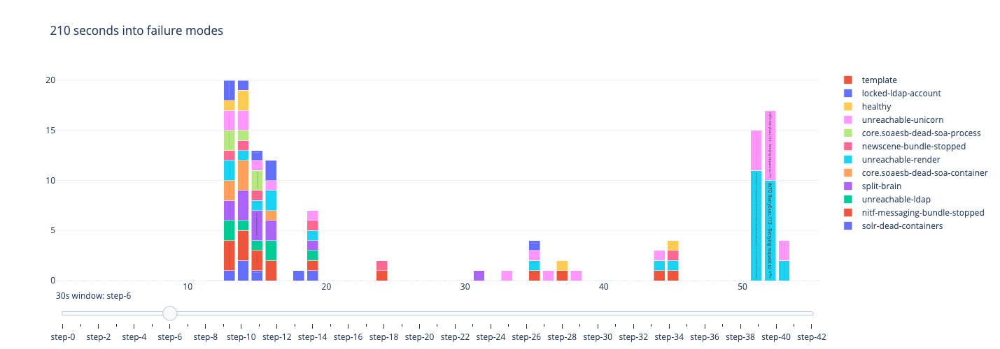

In [41]:
fig = go.Figure()
labels = list(slider_data[0].keys())


for runtime in slider_data.keys():
    # hover_data = []
    for idx in slider_data[runtime].index:
        try:
            cluster = template_miner.drain.cluster[idx]
        except:
            continue
        # hover_data.append(cluster.get_template())
    for label in labels:
        fig.add_trace(
            go.Bar(
                visible=False,
                x=slider_data[runtime].index,
                y=slider_data[runtime][label],
                hoverinfo = "text",
                text=slider_data[runtime]['template'],
                name=label
            )
        )

for i in range(11):
    fig.data[i].visible = True
    
steps = []
j = 0
for i in range(0, len(fig.data), len(labels)):
    j += 1
    step = dict(
        method='update',
        args=[{'visible': [False] * len(fig.data)},
              {'title': f'{j * 30} seconds into failure modes'}],
    )
    for k in range(i, i + len(labels)):
        step['args'][0]['visible'][k]= True
    steps.append(step)
               
    sliders = [dict(
        active = 20,
        currentvalue={'prefix': '30s window: '},
        pad={'t': 10},
        steps=steps
    )]

fig.update_layout(template='plotly_white', sliders=sliders, height = 500, barmode='stack')
fig.show()

In [100]:
slots = pd.concat([pd.DataFrame([time_slot.sum(axis=0)], columns=time_slot.columns) for time_slot in slider_data.values()], ignore_index=True)

In [103]:
slots.drop('template', axis=1, inplace=True)

In [104]:
slots.head()

,solr-dead-containers,nitf-messaging-bundle-stopped,unreachable-ldap,split-brain,core.soaesb-dead-soa-container,unreachable-render,newscene-bundle-stopped,core.soaesb-dead-soa-process,unreachable-unicorn,healthy,locked-ldap-account
0,27,8,8,8,6,35,2,5,16,9,6
1,9,10,10,17,8,22,8,2,30,4,4
2,8,5,5,8,10,23,5,9,12,7,6
3,12,11,19,10,8,19,8,8,28,5,5
4,8,22,7,8,6,39,16,3,22,14,11


In [111]:
slots = slots.diff().drop(0, axis=0)

In [112]:
slots.head()

,solr-dead-containers,nitf-messaging-bundle-stopped,unreachable-ldap,split-brain,core.soaesb-dead-soa-container,unreachable-render,newscene-bundle-stopped,core.soaesb-dead-soa-process,unreachable-unicorn,healthy,locked-ldap-account
1,-18.0,2.0,2.0,9.0,2.0,-13.0,6.0,-3.0,14.0,-5.0,-2.0
2,-1.0,-5.0,-5.0,-9.0,2.0,1.0,-3.0,7.0,-18.0,3.0,2.0
3,4.0,6.0,14.0,2.0,-2.0,-4.0,3.0,-1.0,16.0,-2.0,-1.0
4,-4.0,11.0,-12.0,-2.0,-2.0,20.0,8.0,-5.0,-6.0,9.0,6.0
5,-2.0,-12.0,3.0,0.0,-5.0,-16.0,-11.0,4.0,2.0,-9.0,-7.0


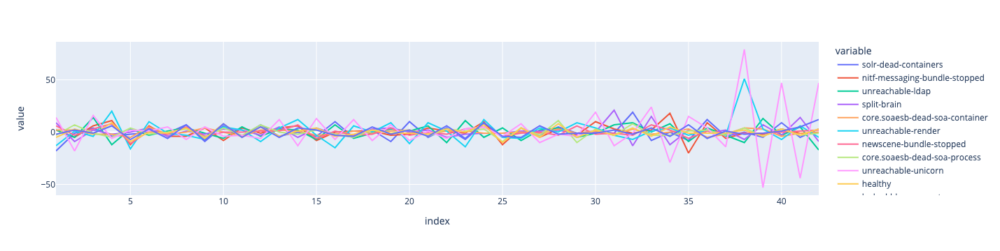

In [113]:
px.line(slots)

In [134]:
all_templates = pd.concat(slider_data.values())

In [136]:
templates_df = all_templates["template"]
templates_df.drop(1, axis=0, inplace=True)
templates_df = templates_df.reset_index()

In [137]:
templates_df.head()

,index,template
0,2,Z INFO harvester/forwarder.go:52 Input outlet ...
1,3,Z INFO log/harvester.go:255 Harvester started ...
2,4,INFO <*> [ ] o.a.s.c.c.ZkStateReader Updated l...
3,5,INFO (zkCallback-5-thread-3) [ ] o.a.s.c.c.ZkS...
4,6,INFO (zkCallback-5-thread-3) [c:alerts s:shard...


In [145]:
templates_df = clean_logs('template', templates_df)
templates_df.head()

,index,template
0,2,Z INFO harvester/forwarder.go:52 Input outlet ...
1,3,Z INFO log/harvester.go:255 Harvester started ...
2,4,INFO <*> [ ] o.a.s.c.c.ZkStateReader Updated l...
3,5,INFO (zkCallback-5-thread-3) [ ] o.a.s.c.c.ZkS...
4,6,INFO (zkCallback-5-thread-3) [c:alerts s:shard...


In [171]:
regexp = re.compile(
    r"""
    [^a-zA-Z]
    """, re.X
)
templates_df_2 = deepcopy(templates_df)
templates_df_2.head()

,index,template
0,2,Z INFO harvester/forwarder.go:52 Input outlet ...
1,3,Z INFO log/harvester.go:255 Harvester started ...
2,4,INFO <*> [ ] o.a.s.c.c.ZkStateReader Updated l...
3,5,INFO (zkCallback-5-thread-3) [ ] o.a.s.c.c.ZkS...
4,6,INFO (zkCallback-5-thread-3) [c:alerts s:shard...


In [172]:
templates_df_2["template"].replace(to_replace=regexp, value=' ', regex=True, inplace=True)
templates_df_2.head()

,index,template
0,2,Z INFO harvester forwarder go Input outlet ...
1,3,Z INFO log harvester go Harvester started ...
2,4,INFO o a s c c ZkStateReader Updated l...
3,5,INFO zkCallback thread o a s c c ZkS...
4,6,INFO zkCallback thread c alerts s shard...


In [173]:
regexp = re.compile(
    r"""
    ((?<=\s)|(?<=\A))[a-zA-Z]{1}((?=\s)|(?=\Z))
    """, re.X
)
templates_df_2["template"].replace(to_replace=regexp, value=' ', regex=True, inplace=True)
templates_df_2.head()

,index,template
0,2,INFO harvester forwarder go Input outlet ...
1,3,INFO log harvester go Harvester started ...
2,4,INFO ZkStateReader Updated l...
3,5,INFO zkCallback thread ZkS...
4,6,INFO zkCallback thread alerts shard...


## Tf-Idf/Word Cloud

In [42]:
all_time_data = pd.concat(slider_data.values())

In [43]:
all_time_data.reset_index(drop=True, inplace=True)
all_time_data["template"].head(), len(all_time_data["template"])

(0                                                   NA
 1    Z INFO harvester/forwarder.go:52 Input outlet ...
 2    Z INFO log/harvester.go:255 Harvester started ...
 3    INFO <*> [ ] o.a.s.c.c.ZkStateReader Updated l...
 4    INFO (zkCallback-5-thread-3) [ ] o.a.s.c.c.ZkS...
 Name: template, dtype: object,
 2322)

In [44]:
fake_df = template_df.copy()

In [45]:
fake_df.reset_index(drop=True, inplace=True)
fake_df["log"].head(), len(fake_df["log"])

(0       Z INFO input/input.go:149 input ticker stopped
 1    Z INFO harvester/forwarder.go:52 Input outlet ...
 2    Z INFO log/harvester.go:255 Harvester started ...
 3    INFO <*> [ ] o.a.s.c.c.ZkStateReader Updated l...
 4    INFO <*> [ ] o.a.s.c.c.ZkStateReader Updated l...
 Name: log, dtype: object,
 34295)

In [46]:
fake_df = fake_df[~fake_df['label'].str.contains("zookeeper")]

In [47]:
all_time_data.drop('zookeeper-dead-containers', axis=1, inplace=True)

KeyError: "['zookeeper-dead-containers'] not found in axis"

In [48]:
all_time_data.head()

,solr-dead-containers,nitf-messaging-bundle-stopped,unreachable-ldap,split-brain,core.soaesb-dead-soa-container,unreachable-render,newscene-bundle-stopped,core.soaesb-dead-soa-process,unreachable-unicorn,healthy,locked-ldap-account,template
0,0,0,0,0,0,0,0,0,0,0,0,NA
1,2,0,0,0,0,0,0,0,0,0,0,Z INFO harvester/forwarder.go:52 Input outlet ...
2,2,0,0,0,0,0,0,0,0,0,0,Z INFO log/harvester.go:255 Harvester started ...
3,3,0,0,0,0,0,0,0,0,0,0,INFO <*> [ ] o.a.s.c.c.ZkStateReader Updated l...
4,1,0,0,0,0,0,0,0,0,0,0,INFO (zkCallback-5-thread-3) [ ] o.a.s.c.c.ZkS...


In [49]:
new_df = []

for template in all_time_data["template"]:
    if (template == "NA"): continue
        
    temp_df = all_time_data[all_time_data["template"] == template]
    temp_df = (temp_df != 0).sum(axis=1)
    if (temp_df.iloc[0] > 2): continue
    
    df2 = fake_df[fake_df["log"] == template]
    new_df.append(df2)

In [50]:
df = pd.concat(new_df).reset_index(drop=True)

In [185]:
df.head()

,container_name,log,label
0,filebeat,Z INFO harvester/forwarder.go:52 Input outlet ...,solr-dead-containers
1,filebeat,Z INFO harvester/forwarder.go:52 Input outlet ...,solr-dead-containers
2,filebeat,Z INFO harvester/forwarder.go:52 Input outlet ...,solr-dead-containers
3,filebeat,Z INFO log/harvester.go:255 Harvester started ...,solr-dead-containers
4,filebeat,Z INFO log/harvester.go:255 Harvester started ...,solr-dead-containers


In [245]:
from sklearn.feature_extraction.text import TfidfVectorizer, TfidfTransformer
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.model_selection import cross_val_score,train_test_split,GridSearchCV
from sklearn.metrics import confusion_matrix, accuracy_score

from sklearn.naive_bayes import MultinomialNB, GaussianNB
from sklearn.ensemble import RandomForestClassifier,BaggingClassifier,ExtraTreesClassifier
from sklearn.tree import DecisionTreeClassifier

from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA

import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px

import os
import sys

from wordcloud import WordCloud

In [244]:
!pip install wordcloud

     |████████████████████████████████| 371 kB 838 kB/s eta 0:00:01


In [247]:
cloud_df = pd.DataFrame([tf_idf.vocabulary_.keys(), tf_idf.vocabulary_.values()])
# Cloud = WordCloud(background_color="white", max_words=50).generate_from_frequencies()

In [250]:
cloud_df.T.head()

,0,1
0,info,170
1,harvester,154
2,forwarder,130
3,go,145
4,input,172


In [174]:
tf_idf = TfidfVectorizer()

In [175]:
X = tf_idf.fit_transform(templates_df_2["template"])

In [253]:
x_list = X.todense().tolist()
y_list = tf_idf.get_feature_names()

In [256]:
test_cloud_df = pd.DataFrame(x_list, columns=y_list)


ac                1.635202
access            1.641547
action           20.524733
active            3.917107
admin            48.898778
                   ...    
wt               10.262367
zero             11.531272
zkcallback       41.903650
zkstatereader    25.087738
zookeeper        67.509350
Length: 388, dtype: float64

In [259]:
Cloud = WordCloud(background_color="white").generate_from_frequencies(test_cloud_df.T.sum(axis=1))

wordcloud = WordCloud(width = 3000, height = 2000, random_state=1, background_color='black', colormap='Set2').generate_from_frequencies(test_cloud_df.T.sum(axis=1))

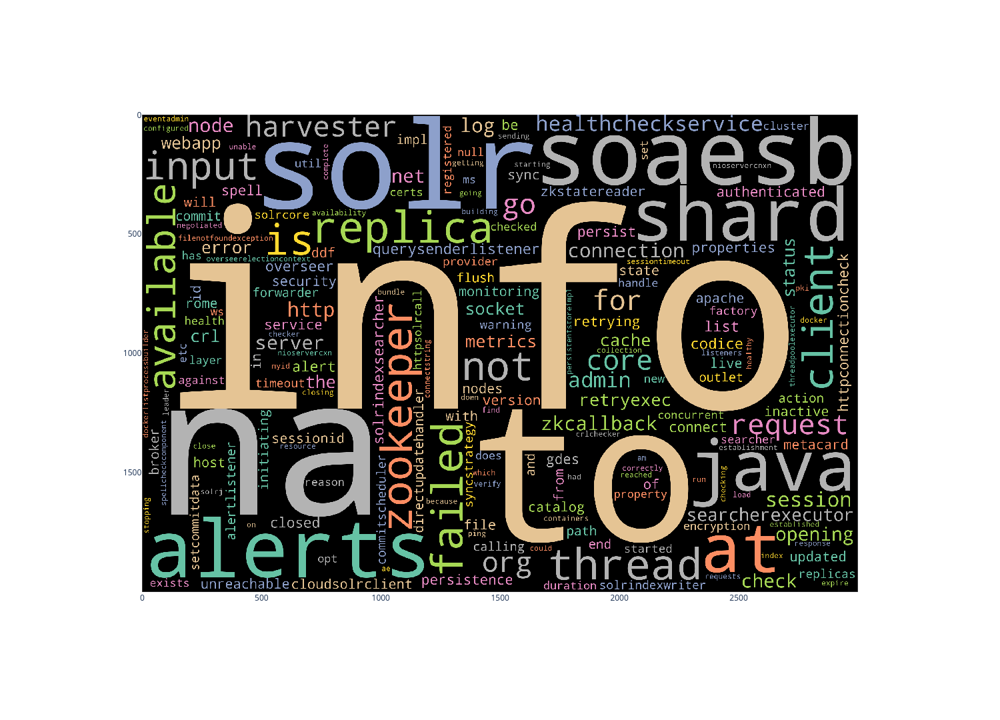

In [262]:
fig = px.imshow(wordcloud)
fig.update_layout(width=1920, height=1080)

In [ ]:
tf_idf.vocabulary_

In [54]:
X = tf_idf.fit_transform(df["log"])

In [55]:
X.shape

(21070, 403)

In [56]:
y = df["label"]
y.shape

(21070,)

In [57]:
X_train, X_test, y_train, y_test = train_test_split(X.toarray(), y, test_size=0.2, shuffle=True)

In [58]:
df["label"].value_counts(normalize=1)[0:1]

nitf-messaging-bundle-stopped    0.173469
Name: label, dtype: float64

In [114]:
classifier = RandomForestClassifier(criterion = 'gini', random_state = 0) 
#classifier = DecisionTreeClassifier(criterion = 'entropy', random_state = 0) 
# classifier = MultinomialNB() #GaussianNB

In [115]:
params = { "n_estimators": [100, 200, 300, 400], "max_depth": [None, 2, 3, 4, 5], "criterion": ["gini", "entropy"] }
gs = GridSearchCV(classifier, param_grid=params)

In [116]:
classifier.fit(X_train, y_train)

RandomForestClassifier(random_state=0)

In [117]:
print(gs.fit(X_train,y_train))

KeyboardInterrupt: 

In [ ]:
print(gs.best_params_)
print("Train Score: ", round(gs.best_score_,4))
print("Train Score: ", round(gs.score(X_test,y_test),4))

In [269]:
classifier_single_tree = DecisionTreeClassifier(criterion = 'entropy', random_state = 0)

In [270]:
params = { "criterion": ["entropy", "gini"], "splitter": ["best", "random"], "max_depth": [None, 3, 4, 5] }

In [271]:
gs = GridSearchCV(classifier_single_tree, param_grid=params)

In [272]:
print(gs.fit(X_train, y_train))

GridSearchCV(estimator=DecisionTreeClassifier(criterion='entropy',
                                              random_state=0),
             param_grid={'criterion': ['entropy', 'gini'],
                         'max_depth': [None, 3, 4, 5],
                         'splitter': ['best', 'random']})


In [273]:
print(gs.best_params_)
print("Train Score: ", round(gs.best_score_,4))
print("Train Score: ", round(gs.score(X_test,y_test),4))

{'criterion': 'entropy', 'max_depth': None, 'splitter': 'random'}
Train Score:  0.5377
Train Score:  0.5382


In [274]:
best_classifier = DecisionTreeClassifier(criterion='entropy', random_state=0, splitter='random', max_depth=None)
lda = LDA(n_components=1)

In [290]:
x_train_lda = lda.fit_transform(X_train, y_train)
x_test_lda = lda.fit_transform(X_test, y_test)

classifier.fit(x_train_lda, y_train)

ValueError: Negative values in data passed to MultinomialNB (input X)

In [ ]:
y_pred = classifier.predict(x_test_lda)
print(accuracy_score(y_pred, y_test))
print(y_pred)

In [ ]:
cm = confusion_matrix(y_test, y_pred, labels=df["label"].unique())
fig = px.imshow(cm)
fig.show()

## W2V + Positive/Negative N-Grams

In [ ]:
previous_timestamp = df_logs_as_templates.index.min()
breaks = []
for timestamp in df_logs_as_templates.index:
    if timestamp - previous_timestamp > timedelta(minutes=15):
        breaks.append(timestamp)
    previous_timestamp = timestamp

In [ ]:
cleaned_logs['log'] = cleaned_logs['log'].str.lower()
cleaned_logs['log'] = cleaned_logs['log'].str.replace(',', ' ')

In [ ]:
clean_tokens = cleaned_logs['log'].str.split(' ', expand=True).stack()
unique_tokens = list(clean_tokens.unique())
unique_tokens_pd = pd.DataFrame(unique_tokens)

In [ ]:
len(unique_tokens_pd)

50147

In [ ]:
vocab, index = {}, 1  # start indexing from 1
vocab['<pad>'] = 0  # add a padding token
for token in unique_tokens:
  if token not in vocab:
    vocab[token] = index
    index += 1
vocab_size = len(vocab)

In [ ]:
inverse_vocab = {index: token for token, index in vocab.items()}

In [ ]:
example_word_log_1 = list(cleaned_logs['log'].iloc[0].split(' '))
example_sequence = [vocab[word] for word in example_word_log_1]

In [ ]:
window_size = 2
positive_skip_grams, _ = tf.keras.preprocessing.sequence.skipgrams(
      example_sequence,
      vocabulary_size=vocab_size,
      window_size=window_size,
      negative_samples=0)

In [ ]:
# Get target and context words for one positive skip-gram.
target_word, context_word = positive_skip_grams[0]

# Set the number of negative samples per positive context.
num_ns = 4

context_class = tf.reshape(tf.constant(context_word, dtype="int64"), (1, 1))
negative_sampling_candidates, _, _ = tf.random.log_uniform_candidate_sampler(
    true_classes=context_class,  # class that should be sampled as 'positive'
    num_true=1,  # each positive skip-gram has 1 positive context class
    num_sampled=num_ns,  # number of negative context words to sample
    unique=True,  # all the negative samples should be unique
    range_max=vocab_size,  # pick index of the samples from [0, vocab_size]
    seed=0,  # seed for reproducibility
    name="negative_sampling"  # name of this operation
)

2021-10-14 14:19:24.360124: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2021-10-14 14:19:24.361279: I tensorflow/compiler/jit/xla_gpu_device.cc:99] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-10-14 14:19:24.361483: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-10-14 14:19:24.362014: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: NVIDIA GeForce RTX 2070 SUPER computeCapability: 7.5
coreClock: 1.8GHz coreCount: 40 deviceMemorySize: 7.79GiB deviceMemoryBandwidth: 417.29GiB/s
2021-10-1

In [ ]:
# Add a dimension so you can use concatenation (on the next step).
negative_sampling_candidates = tf.expand_dims(negative_sampling_candidates, 1)

# Concat positive context word with negative sampled words.
context = tf.concat([context_class, negative_sampling_candidates], 0)

# Label first context word as 1 (positive) followed by num_ns 0s (negative).
label = tf.constant([1] + [0]*num_ns, dtype="int64")

# Reshape target to shape (1,) and context and label to (num_ns+1,).
target = tf.squeeze(target_word)
context = tf.squeeze(context)
label = tf.squeeze(label)

In [ ]:
cleaned_logs_labels = tf.convert_to_tensor(cleaned_logs["label"])
cleaned_logs_tensor = tf.convert_to_tensor(cleaned_logs["log"])

In [ ]:
text_ds = tf.data.Dataset.from_tensor_slices(cleaned_logs_tensor).filter(lambda x: tf.cast(tf.strings.length(x), bool))

In [ ]:
text_ds.batch(1024)

<BatchDataset shapes: (None,), types: tf.string>

In [ ]:
def standardize_log(log):
  lowercase = tf.strings.lower(log)
  return tf.strings.regex_replace(lowercase,
                                  '[%s]' % re.escape(string.punctuation), ' ')


def generate_training_data(sequences, window_size, num_ns, vocab_size):
  targets, contexts, labels = [], [], []

  sampling_table = tf.keras.preprocessing.sequence.make_sampling_table(vocab_size)

  for sequence in tqdm.tqdm(sequences):

    positive_skip_grams, _ = tf.keras.preprocessing.sequence.skipgrams(
          sequence,
          vocabulary_size=vocab_size,
          sampling_table=sampling_table,
          window_size=window_size,
          negative_samples=0)
    
    for target_word, context_word in positive_skip_grams:
      context_class = tf.expand_dims(
          tf.constant([context_word], dtype="int64"), 1)
      negative_sampling_candidates, _, _ = tf.random.log_uniform_candidate_sampler(
          true_classes=context_class,  # class that should be sampled as 'positive'
          num_true=1,  # each positive skip-gram has 1 positive context class
          num_sampled=num_ns,  # number of negative context words to sample
          unique=True,  # all the negative samples should be unique
          range_max=vocab_size,  # pick index of the samples from [0, vocab_size]
          seed=0,  # seed for reproducibility
          name="negative_sampling"  # name of this operation
      )

      # Add a dimension so you can use concatenation (on the next step).
      negative_sampling_candidates = tf.expand_dims(negative_sampling_candidates, 1)

      # Concat positive context word with negative sampled words.
      context = tf.concat([context_class, negative_sampling_candidates], 0)

      # Label first context word as 1 (positive) followed by num_ns 0s (negative).
      label = tf.constant([1] + [0]*num_ns, dtype="int64")

      targets.append(target_word)
      contexts.append(context)
      labels.append(label)

  return targets, contexts, labels

In [ ]:
# Define the vocabulary size and number of words in a sequence.
vocab_size = 12000
sequence_length = 256

# Use the TextVectorization layer to normalize, split, and map strings to
# integers. Set output_sequence_length length to pad all samples to same length.
vectorize_layer = tf.keras.layers.experimental.preprocessing.TextVectorization(
    standardize=standardize_log,
    max_tokens=vocab_size,
    output_mode='int',
    output_sequence_length=sequence_length)

In [ ]:
vectorize_layer.adapt(text_ds.batch(1024))

2021-10-14 14:19:34.575165: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:116] None of the MLIR optimization passes are enabled (registered 2)
2021-10-14 14:19:34.594568: I tensorflow/core/platform/profile_utils/cpu_utils.cc:112] CPU Frequency: 4200000000 Hz


In [ ]:
len(vectorize_layer.get_vocabulary())

12000

In [ ]:
# Save the created vocabulary for reference.
inverse_vocab = vectorize_layer.get_vocabulary()
print(inverse_vocab[:20])

['', '[UNK]', 'java', 'at', '1', 'info', '2', 'healthcheckservice', '0', 'org', 'apache', '106', 'status', 'jar', 'to', 'container', 'zookeeper', 'camel', '4', 'up']


In [ ]:
# Vectorize the data in text_ds.
text_vector_ds = text_ds.batch(1024).prefetch(tf.data.AUTOTUNE).map(vectorize_layer).unbatch()

In [ ]:
sequences = list(text_vector_ds.as_numpy_iterator())
print(len(sequences))

209363


In [ ]:
for seq in sequences[:5]:
  print(f"{seq} => {[inverse_vocab[i] for i in seq]}")

[   5 2463  706   98    6  139  153   53   46  238   26  554  245  153
   46   54   88   49   58   53  627  238 2177  113 2536    9   10   22
   83 1998 2177    1 2534   81 2551   22   26  153   46   54   88   96
  676   81 2561   62   81   90 1999   22   26  153   46   54   88   28
 2554   83 2543    1    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0 

In [ ]:
num_ns=4

In [ ]:
targets, contexts, labels = generate_training_data(
    sequences=sequences,
    window_size=2,
    num_ns=num_ns,
    vocab_size=vocab_size)

targets = np.array(targets)
contexts = np.array(contexts)[:,:,0]
labels = np.array(labels)

print('\n')
print(f"targets.shape: {targets.shape}")
print(f"contexts.shape: {contexts.shape}")
print(f"labels.shape: {labels.shape}")

100%|██████████| 209363/209363 [08:52<00:00, 393.04it/s] 




targets.shape: (2072518,)
contexts.shape: (2072518, 5)
labels.shape: (2072518, 5)


In [ ]:
joblib.dump(targets, 'results/targets.joblib')
joblib.dump(contexts, 'results/contexts.joblib')
joblib.dump(labels, 'results/labels.joblib')

['results/labels.joblib']

In [ ]:
BATCH_SIZE = 1024
BUFFER_SIZE = 10000
dataset = tf.data.Dataset.from_tensor_slices(((targets, contexts), labels))
dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE, drop_remainder=True)
print(dataset)

<BatchDataset shapes: (((1024,), (1024, 5)), (1024, 5)), types: ((tf.int64, tf.int64), tf.int64)>


In [ ]:
dataset = dataset.cache().prefetch(buffer_size=tf.data.AUTOTUNE)
print(dataset)

<PrefetchDataset shapes: (((1024,), (1024, 5)), (1024, 5)), types: ((tf.int64, tf.int64), tf.int64)>


In [ ]:
class Word2Vec(tf.keras.Model):
  def __init__(self, vocab_size, embedding_dim):
    super(Word2Vec, self).__init__()
    self.target_embedding = tf.keras.layers.Embedding(
        vocab_size,
        embedding_dim,
        input_length=1,
        name="w2v_embedding"
    )
    self.context_embedding = tf.keras.layers.Embedding(
        vocab_size,
        embedding_dim,
        input_length=4+1
    )

  def call(self, pair):
    target, context = pair
    # target: (batch, dummy?)  # The dummy axis doesn't exist in TF2.7+
    # context: (batch, context)
    if len(target.shape) == 2:
      target = tf.squeeze(target, axis=1)
    # target: (batch,)
    word_emb = self.target_embedding(target)
    # word_emb: (batch, embed)
    context_emb = self.context_embedding(context)
    # context_emb: (batch, context, embed)
    dots = tf.einsum('be,bce->bc', word_emb, context_emb)
    # dots: (batch, context)
    return dots

In [ ]:
embedding_dim = 512
w2v = Word2Vec(vocab_size, embedding_dim)
w2v.compile(optimizer='adam',
            loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True),
            metrics=['accuracy'])

In [ ]:
w2v.fit(dataset, epochs=3)

Epoch 1/3


2021-10-13 02:08:53.266414: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcublas.so.11


  3/240 [..............................] - ETA: 17s - loss: 1.6075 - accuracy: 0.2422

2021-10-13 02:08:53.654830: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcublasLt.so.11


240/240 [==============================] - 14s 54ms/step - loss: 1.2718 - accuracy: 0.7627
Epoch 2/3
240/240 [==============================] - 13s 53ms/step - loss: 0.3687 - accuracy: 0.9445
Epoch 3/3
240/240 [==============================] - 13s 54ms/step - loss: 0.1457 - accuracy: 0.9686


In [ ]:
joblib.dump(w2v.get_layer('w2v_embedding').get_weights()[0], "results/w2v_embeddings.joblib")

['results/w2v_embeddings.joblib']

# Random Forest

## Prepare embeddings for Random Forest

Each embedding has a length of 512 (embedding_dim) and there are 256 embeddings per log. The logs are batched 1024 at a time. We will need to pass in a single vector to the random forest classifier for each batch. 

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.decomposition import PCA

weights = joblib.load('results/w2v_embeddings.joblib')

In [ ]:
label_encoder = LabelEncoder()
label_encoder = label_encoder.fit(cleaned_logs['label'].unique())

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
    cleaned_logs['log'], cleaned_logs['label'], test_size=0.25, random_state=0, shuffle=False)

In [ ]:
X_test

11960      error [org.apache.activemq.artemis.core.serv...
11961      error [org.apache.activemq.artemis.core.serv...
11962      error [org.apache.activemq.artemis.core.serv...
11963      error [org.apache.activemq.artemis.core.serv...
11964     info healthcheckservice:106 - healthy unicorn...
                               ...                        
15942      error 1 ...
15943     info sftpconnectioncheck:89 - could not conne...
15944      error [org.apache.activemq.artemis.core.serv...
15945      error [org.apache.activemq.artemis.core.serv...
15946     info healthcheckservice:106 - healthy unicorn...
Name: log, Length: 3987, dtype: object

In [ ]:
def embed_tokens(tensor):
  return tf.constant(weights[tensor.numpy()])

In [ ]:
encoded_seq = vectorize_layer(X_train[0:1024])

In [ ]:
batch_tensor = tf.map_fn(embed_tokens, encoded_seq, fn_output_signature=tf.float32)

In [ ]:
tf_avg_tokens = tf.math.reduce_mean(batch_tensor, axis=1)
tf_avg_embed_dims = tf.math.reduce_mean(tf_avg_tokens, axis=1)
tf_avg_embed_dims

<tf.Tensor: shape=(1024,), dtype=float32, numpy=
array([-0.00098837, -0.00114544, -0.00116906, ..., -0.00122365,
       -0.0010807 , -0.00116096], dtype=float32)>

In [ ]:
def rf_data_gen(X, y):
    
    batch_size = 75
    n_iters = int(len(X) / batch_size)
    samples = []
    labels = []
        
    for i in range(n_iters):
        label = label_encoder.transform(y[i*batch_size:(i + 1)*batch_size])
        encoded_seq = vectorize_layer(X[i*batch_size:(i + 1)*batch_size])
        batch_embeddings = tf.map_fn(embed_tokens, encoded_seq, fn_output_signature=tf.float32)
        tf_avg_tokens = tf.math.reduce_mean(batch_embeddings, axis=1)
        ret = tf.math.reduce_mean(tf_avg_tokens, axis=1)
        samples.append(tf_avg_tokens)
        labels.append(label)
    
    return samples, labels

In [ ]:
rf_cls = RandomForestClassifier(warm_start = True)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
        cleaned_logs['log'],
        cleaned_logs['label'],
        test_size = 0.25,
        random_state = 42,
        shuffle = False)

In [ ]:
s, l = rf_data_gen(np.array(X_train), np.array(y_train))

In [ ]:
rf_cls.fit(s, l)

ValueError: Found array with dim 3. Estimator expected <= 2.

In [ ]:
s_pred, l_pred = rf_data_gen(np.array(X_test), np.array(y_test))

In [ ]:
preds = rf_cls.predict(s_pred)

In [ ]:
y_test

11960    core.soaesb-dead-soa-container
11961    core.soaesb-dead-soa-container
11962    core.soaesb-dead-soa-container
11963    core.soaesb-dead-soa-container
11964    core.soaesb-dead-soa-container
                      ...              
15942                unreachable-render
15943                unreachable-render
15944                unreachable-render
15945                unreachable-render
15946                unreachable-render
Name: label, Length: 3987, dtype: object

In [ ]:
cm = confusion_matrix(preds, l_pred)

In [ ]:
fig = px.imshow(
    cm,
    x = logs['label'].unique(),
    y = logs['label'].unique()
)

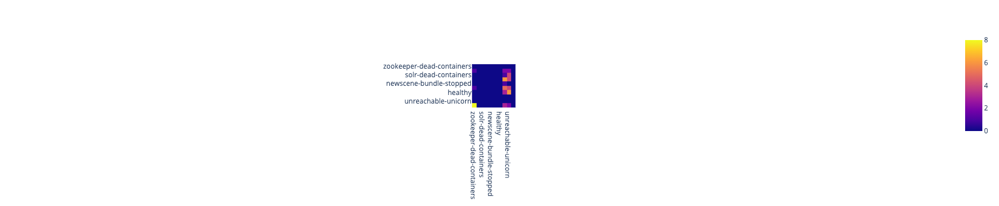

In [ ]:
fig.show()

In [ ]:
def train_random_forest(num_of_epochs: int):
    for j in tqdm.trange(num_of_epochs):
        train_gen = rf_data_gen(X_train, y_train)
        for X, y in train_gen:
            print(y.shape)
            rf_cls.fit(X, y)
            rf_cls.n_estimators += 1

In [ ]:
train_random_forest(10)

In [ ]:
def test_random_forest():
    y_preds = []
    test_gen = rf_data_gen(X_test, y_test)
    for X, _ in test_gen:
        print(X.shape)
        y_pred = rf_cls.predict(X)
        print(y_pred.shape)
        y_preds.append(y_pred)

In [ ]:
test_random_forest()

In [ ]:

# def train_random_forest(batch_size):
#   r = int(len(X_train) / batch_size)
#   for i in range(1, r + 1):
#     encoded_seq = vectorize_layer(X_train[(i-1)*batch_size:i*batch_size])
#     label = label_encoder.transform(y_train[(i-1)*batch_size:i*batch_size])

#     input = tf.map_fn(embed_tokens, encoded_seq, fn_output_signature=tf.float32).numpy()
    
#     for j in tqdm.trange(len(input), desc=f"Iteration {i}/{r}"):
#       # new_input = pca.fit_transform(input[j]).reshape(256,)
#       #new_input = pca.transform(input[j]).reshape(256, )
#       rf_clf.fit([input], [label[j]]) # * 256)

#     if (r >= 1):
#       break

# def test_random_forest(batch_size):
#   y_pred = []
#   r = int(len(X_test) / batch_size)
#   for i in range(1, r + 1):
#     encoded_seq = vectorize_layer(X_test[(i-1)*batch_size:i*batch_size])

#     input = tf.map_fn(embed_tokens, encoded_seq, fn_output_signature=tf.float32).numpy()
    
#     for j in tqdm.trange(len(input), desc=f"Iteration {i}/{r}"):
#       #new_input = pca.transform(input[j]).reshape(256, )
#       y_pred.append(rf_clf.predict([input])[0])

#   return y_pred

In [ ]:
weights = w2v.get_layer('w2v_embedding').get_weights()[0]
train_random_forest(1024)

# CNN

In [ ]:
from tensorflow.keras import datasets, layers, models

In [ ]:
model = models.Sequential()
model.add(layers.Conv2D(75, (3, 3), activation='relu', input_shape=(75, 256, 512)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(150, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(150, (3, 3), activation='relu'))
model.add(layers.Flatten())
model.add(layers.Dense(150, activation='relu'))
model.add(layers.Dense(10))

In [ ]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_3 (Conv2D)            (None, 73, 254, 75)       345675    
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 36, 127, 75)       0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 34, 125, 150)      101400    
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 17, 62, 150)       0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 15, 60, 150)       202650    
_________________________________________________________________
flatten (Flatten)            (None, 135000)            0         
_________________________________________________________________
dense (Dense)                (None, 150)              

In [ ]:
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [ ]:
def cnn_data_gen(X, y):
    
    batch_size = 75
    n_iters = int(len(X) / batch_size)
        
    for i in range(n_iters):
        label = label_encoder.transform(y[i*batch_size:(i + 1)*batch_size])
        encoded_seq = vectorize_layer(X[i*batch_size:(i + 1)*batch_size])
        batch_embeddings = tf.map_fn(embed_tokens, encoded_seq, fn_output_signature=tf.float32)
    
        yield batch_embeddings, label[0]

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
        cleaned_logs['log'],
        cleaned_logs['label'],
        test_size = 0.25,
        random_state = 42,
        shuffle = False)

In [ ]:
X_train = vectorize_layer(X_train)
X_train = tf.map_fn(embed_tokens, X_train, fn_output_signature=tf.float32)

In [ ]:
X_train

<tf.Tensor: shape=(11960, 256), dtype=int64, numpy=
array([[ 288, 1472,   64, ...,    0,    0,    0],
       [ 172,   46,  528, ...,    0,    0,    0],
       [ 284,   37,   73, ...,    0,    0,    0],
       ...,
       [  26,   25,   38, ...,    0,    0,    0],
       [  26,   25,   38, ...,    0,    0,    0],
       [  34,  106,   34, ...,    5,    6,    7]])>

In [ ]:
history = model.fit(train_images, train_labels, epochs=10, 
                    validation_data=(test_images, test_labels))